## Read data from Google Drive:

In [ ]:
!pip install PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)
downloaded = drive.CreateFile({'id':"1z8XATU_HOIOgTgjIcTZm5jrFrn1vh8OC"})
downloaded.GetContentFile('train_users.csv')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Frist step (Pre-Processing):

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import seaborn as sns
import statistics
import matplotlib.pyplot as plt
import plotly.express as px
from matplotlib.ticker import PercentFormatter
import plotly.graph_objs as go
import missingno as msno
##missingno provides a small toolset of flexible and easy-to-use missing data visualizations and utilities that allows you to get a quick visual summary of the completeness (or lack thereof) of your dataset.
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from xgboost.sklearn import XGBClassifier
from prophet import Prophet


In [ ]:
# Reading the data
data = pd.read_csv (r'train_users.csv')
# Making a backup copy of the data
data_origenal=data.copy()

In [ ]:
data.head(30)

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
0,gxn3p5htnn,2010-06-28,20090319043255,NaN,-unknown-,NaN,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,NDF
1,820tgsjxq7,2011-05-25,20090523174809,NaN,MALE,38.0,facebook,0,en,seo,google,untracked,Web,Mac Desktop,Chrome,NDF
2,4ft3gnwmtx,2010-09-28,20090609231247,2010-08-02,FEMALE,56.0,basic,3,en,direct,direct,untracked,Web,Windows Desktop,IE,US
3,bjjt8pjhuk,2011-12-05,20091031060129,2012-09-08,FEMALE,42.0,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Firefox,other
4,87mebub9p4,2010-09-14,20091208061105,2010-02-18,-unknown-,41.0,basic,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,US
5,osr2jwljor,2010-01-01,20100101215619,2010-01-02,-unknown-,NaN,basic,0,en,other,other,omg,Web,Mac Desktop,Chrome,US
6,lsw9q7uk0j,2010-01-02,20100102012558,2010-01-05,FEMALE,46.0,basic,0,en,other,craigslist,untracked,Web,Mac Desktop,Safari,US
7,0d01nltbrs,2010-01-03,20100103191905,2010-01-13,FEMALE,47.0,basic,0,en,direct,direct,omg,Web,Mac Desktop,Safari,US
8,a1vcnhxeij,2010-01-04,20100104004211,2010-07-29,FEMALE,50.0,basic,0,en,other,craigslist,untracked,Web,Mac Desktop,Safari,US
9,6uh8zyj2gn,2010-01-04,20100104023758,2010-01-04,-unknown-,46.0,basic,0,en,other,craigslist,omg,Web,Mac Desktop,Firefox,US


In [ ]:
#Display shape of data
data.shape

(213451, 16)

In [ ]:
# Displaying the columns info
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 213451 entries, 0 to 213450
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   id                       213451 non-null  object 
 1   date_account_created     213451 non-null  object 
 2   timestamp_first_active   213451 non-null  int64  
 3   date_first_booking       88908 non-null   object 
 4   gender                   213451 non-null  object 
 5   age                      125461 non-null  float64
 6   signup_method            213451 non-null  object 
 7   signup_flow              213451 non-null  int64  
 8   language                 213451 non-null  object 
 9   affiliate_channel        213451 non-null  object 
 10  affiliate_provider       213451 non-null  object 
 11  first_affiliate_tracked  207386 non-null  object 
 12  signup_app               213451 non-null  object 
 13  first_device_type        213451 non-null  object 
 14  firs

In [ ]:
#Detecing columns which contain missing values
data.isnull().any()

id                         False
date_account_created       False
timestamp_first_active     False
date_first_booking          True
gender                     False
age                         True
signup_method              False
signup_flow                False
language                   False
affiliate_channel          False
affiliate_provider         False
first_affiliate_tracked     True
signup_app                 False
first_device_type          False
first_browser              False
country_destination        False
dtype: bool

In [ ]:
# Detecting the presence of null values in the whole table
data.isnull().sum()

id                              0
date_account_created            0
timestamp_first_active          0
date_first_booking         124543
gender                          0
age                         87990
signup_method                   0
signup_flow                     0
language                        0
affiliate_channel               0
affiliate_provider              0
first_affiliate_tracked      6065
signup_app                      0
first_device_type               0
first_browser                   0
country_destination             0
dtype: int64

**We can see that we have three columns containing missing values**

*   date_first_booking
*   age
*   first_affiliate_tracked





In [ ]:
#percentage of null values.
print('Date first booking null value percentage : ',(data['date_first_booking'].isnull().sum()/len(data['date_first_booking'])*100),'%\n')
print('Age null value percentage : ',(data['age'].isnull().sum()/len(data['age'])*100),'%\n')
print('first_affiliate_tracked null value percentage : ',(data['first_affiliate_tracked'].isnull().sum()/len(data['first_affiliate_tracked'])*100),'%\n')

Date first booking null value percentage :  58.34734904029496 %

Age null value percentage :  41.222575673105304 %

first_affiliate_tracked null value percentage :  2.84140153946339 %



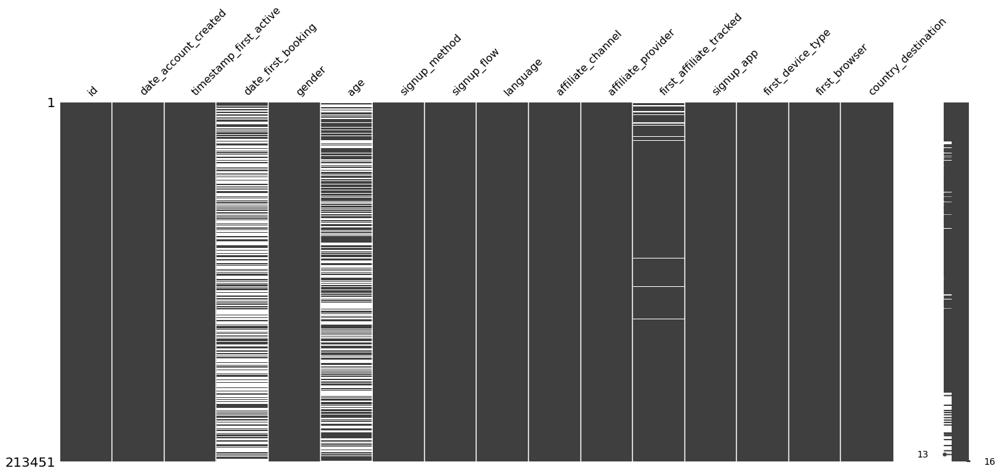

In [ ]:
msno.matrix(data)

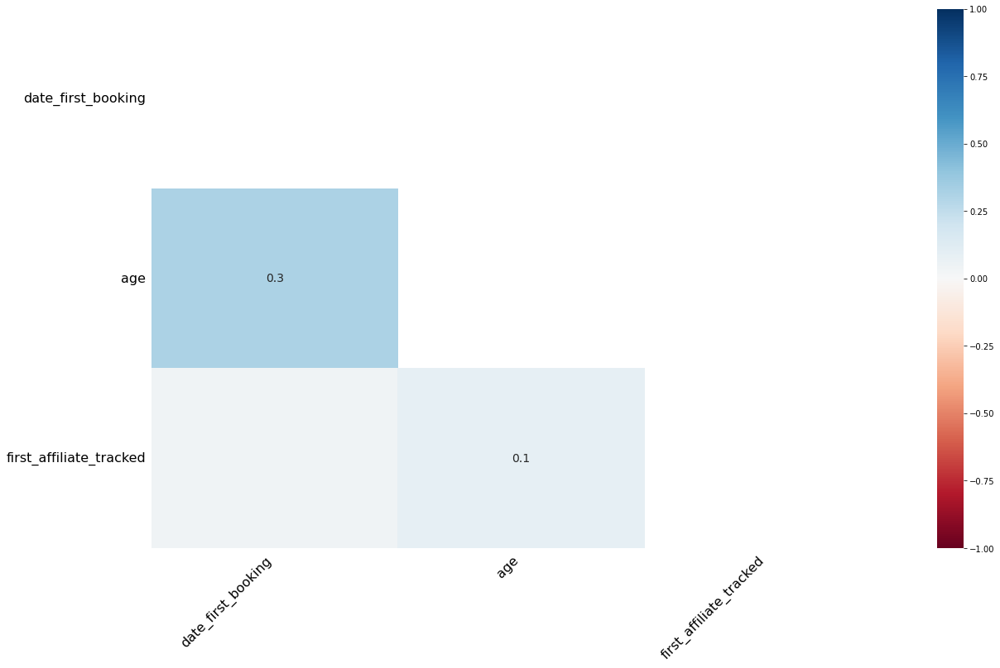

In [ ]:
# here we check if the null values have conncections with each other(e.g. if age nullvalues have a relation with any of the nulls in any other columns)
# the fact is that correlation between the nulls is approximetly=0 which indicate that there is no relation in missing values
#this indecates that there no mean to say that for example when age is null date first booking is null.
msno.heatmap(data)

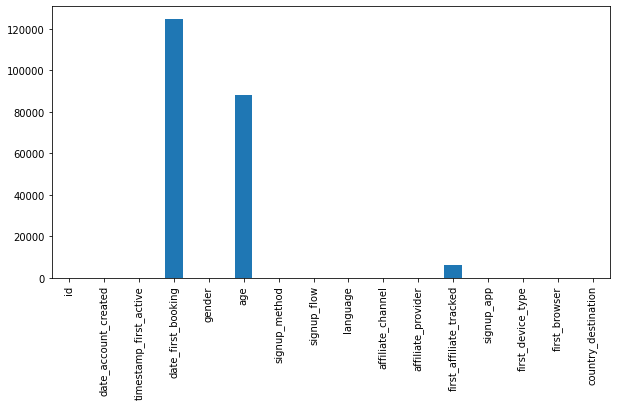

In [ ]:
plt.figure(figsize=(10,5))
data.isnull().sum().plot(kind="bar")
plt.show()

In [ ]:
# Detecting the redundancy in column "id"
## so for each row each id is considersed like a primary key
sum(data['id'].value_counts()>1)

0

### distribute -unknown- valuse in gender with the same ratio on Female, male and others.

In [ ]:
# Displaying the value count of each gender
data['gender'].value_counts()

-unknown-    95688
FEMALE       63041
MALE         54440
OTHER          282
Name: gender, dtype: int64

In [ ]:
# Calculating the percentage value of each gender without "-unknown-"
print(sum(data['gender']=='MALE')/sum(data['gender']!='-unknown-')*100)
print(sum(data['gender']=='FEMALE')/sum(data['gender']!='-unknown-')*100)
print(sum(data['gender']=='OTHER')/sum(data['gender']!='-unknown-')*100)

46.228441870536585
53.53209412124351
0.23946400821989927


In [ ]:
# Distributing the gender of the unknown values with almost the same ratio on : "MALE", "FEMALE" & "OTHER"
data['gender'].replace('-unknown-',None,inplace = True)

In [ ]:
# Displaying the value count of the cleaned gender column; concluding that there is a remaining "-unkown-" value
data['gender'].value_counts()

FEMALE       114513
MALE          98433
OTHER           504
-unknown-         1
Name: gender, dtype: int64

In [ ]:
data["gender"].isnull().sum()

0

In [ ]:
# Calculating the percentage value of each gender without "-unknown-"
print(sum(data['gender']=='MALE')/sum(data['gender']!='-unknown-')*100)
print(sum(data['gender']=='FEMALE')/sum(data['gender']!='-unknown-')*100)
print(sum(data['gender']=='OTHER')/sum(data['gender']!='-unknown-')*100)

46.115249472944484
53.64862965565707
0.23612087139845395


In [ ]:
# Replacing the remaining "-unknown-" value to 'OTHER' because the percentage of OTHER after is lower than the percentage of OTHER before
data['gender'].replace('-unknown-','OTHER',inplace = True)

In [ ]:
# Displaying the cleaned value counts of gender column
data['gender'].value_counts()

FEMALE    114513
MALE       98433
OTHER        505
Name: gender, dtype: int64

In [ ]:
# Calculating the percentage value of each gender
print(sum(data['gender']=='MALE')/len(data['gender'])*100)
print(sum(data['gender']=='FEMALE')/len(data['gender'])*100)
print(sum(data['gender']=='OTHER')/len(data['gender'])*100)

46.11503342687549
53.6483783163349
0.23658825678961448


### **Convert Columns types to correct types**

In [ ]:
# Displaying the incorrect timestamp form
data.head()

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
0,gxn3p5htnn,2010-06-28,20090319043255,NaN,OTHER,NaN,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,NDF
1,820tgsjxq7,2011-05-25,20090523174809,NaN,MALE,38.0,facebook,0,en,seo,google,untracked,Web,Mac Desktop,Chrome,NDF
2,4ft3gnwmtx,2010-09-28,20090609231247,2010-08-02,FEMALE,56.0,basic,3,en,direct,direct,untracked,Web,Windows Desktop,IE,US
3,bjjt8pjhuk,2011-12-05,20091031060129,2012-09-08,FEMALE,42.0,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Firefox,other
4,87mebub9p4,2010-09-14,20091208061105,2010-02-18,FEMALE,41.0,basic,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,US


In [ ]:
data.info() #show data info

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 213451 entries, 0 to 213450
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   id                       213451 non-null  object 
 1   date_account_created     213451 non-null  object 
 2   timestamp_first_active   213451 non-null  int64  
 3   date_first_booking       88908 non-null   object 
 4   gender                   213451 non-null  object 
 5   age                      125461 non-null  float64
 6   signup_method            213451 non-null  object 
 7   signup_flow              213451 non-null  int64  
 8   language                 213451 non-null  object 
 9   affiliate_channel        213451 non-null  object 
 10  affiliate_provider       213451 non-null  object 
 11  first_affiliate_tracked  207386 non-null  object 
 12  signup_app               213451 non-null  object 
 13  first_device_type        213451 non-null  object 
 14  firs

####Convert date & time columns

In [ ]:
# Displaying column "timestamp_first_active"
data['timestamp_first_active']

0         20090319043255
1         20090523174809
2         20090609231247
3         20091031060129
4         20091208061105
               ...      
213446    20140630235636
213447    20140630235719
213448    20140630235754
213449    20140630235822
213450    20140630235824
Name: timestamp_first_active, Length: 213451, dtype: int64

In [ ]:
data['timestamp_first_active']=pd.to_datetime(data['timestamp_first_active'], format='%Y%m%d%H%M%S') #Convert type into date

In [ ]:
data.date_account_created = pd.to_datetime(data.date_account_created, format="%Y-%m-%d") #Convert type into date

In [ ]:
data["date_first_booking"] =pd.to_datetime(data['date_first_booking'],format='%Y-%m-%d') #Convert type into date

####Convert Categorical columns

In [ ]:
data.gender =data.gender.astype("category") #Convert type into category
data.signup_method = data.signup_method.astype("category") #Convert type into category
for column in range(7,16):
  data.iloc[:,column] = data.iloc[:,column].astype("category") #Convert type into category for all columns from 8 to 16

In [ ]:
data.info()  #show data info

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 213451 entries, 0 to 213450
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   id                       213451 non-null  object        
 1   date_account_created     213451 non-null  datetime64[ns]
 2   timestamp_first_active   213451 non-null  datetime64[ns]
 3   date_first_booking       88908 non-null   datetime64[ns]
 4   gender                   213451 non-null  category      
 5   age                      125461 non-null  float64       
 6   signup_method            213451 non-null  category      
 7   signup_flow              213451 non-null  category      
 8   language                 213451 non-null  category      
 9   affiliate_channel        213451 non-null  category      
 10  affiliate_provider       213451 non-null  category      
 11  first_affiliate_tracked  207386 non-null  category      
 12  signup_app      

In [ ]:
data.head(10)  #show first 10 rows in data

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
0,gxn3p5htnn,2010-06-28,2009-03-19 04:32:55,NaT,OTHER,NaN,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,NDF
1,820tgsjxq7,2011-05-25,2009-05-23 17:48:09,NaT,MALE,38.0,facebook,0,en,seo,google,untracked,Web,Mac Desktop,Chrome,NDF
2,4ft3gnwmtx,2010-09-28,2009-06-09 23:12:47,2010-08-02,FEMALE,56.0,basic,3,en,direct,direct,untracked,Web,Windows Desktop,IE,US
3,bjjt8pjhuk,2011-12-05,2009-10-31 06:01:29,2012-09-08,FEMALE,42.0,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Firefox,other
4,87mebub9p4,2010-09-14,2009-12-08 06:11:05,2010-02-18,FEMALE,41.0,basic,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,US
5,osr2jwljor,2010-01-01,2010-01-01 21:56:19,2010-01-02,FEMALE,NaN,basic,0,en,other,other,omg,Web,Mac Desktop,Chrome,US
6,lsw9q7uk0j,2010-01-02,2010-01-02 01:25:58,2010-01-05,FEMALE,46.0,basic,0,en,other,craigslist,untracked,Web,Mac Desktop,Safari,US
7,0d01nltbrs,2010-01-03,2010-01-03 19:19:05,2010-01-13,FEMALE,47.0,basic,0,en,direct,direct,omg,Web,Mac Desktop,Safari,US
8,a1vcnhxeij,2010-01-04,2010-01-04 00:42:11,2010-07-29,FEMALE,50.0,basic,0,en,other,craigslist,untracked,Web,Mac Desktop,Safari,US
9,6uh8zyj2gn,2010-01-04,2010-01-04 02:37:58,2010-01-04,FEMALE,46.0,basic,0,en,other,craigslist,omg,Web,Mac Desktop,Firefox,US


### solution of inaccurate values in age

In [ ]:
# Detecting the amount of age values that's higher than 1015 yo
sum(data['age']>1015)

779

In [ ]:
# Collecting all of the above range ages in a new array called "a"
a=list()
for i in data['age']:
  if i > 1015:
    a.append(i)

pd.DataFrame(a).value_counts()

2014.0    710
2013.0     39
1931.0      3
1949.0      3
1932.0      3
1947.0      2
1924.0      2
1929.0      2
1928.0      2
1936.0      2
1933.0      1
1935.0      1
1925.0      1
1938.0      1
1942.0      1
1927.0      1
1952.0      1
1953.0      1
1995.0      1
2008.0      1
1926.0      1
dtype: int64

the incorrect values in age are dates (years)
so we can know the age by Subtract age date from date when the this data is created

In [ ]:
for i in set(a):
  b=data.index[data['age'] == i].tolist() #store all index of value 'i' in list b
  while len(b)!=0:
    if ( (data.date_account_created[b[0]].year - data['age'][b[0]]) < 0 ): #if date_account_created less than age date
      data['age'][b[0]] = 2015 - data['age'][b[0]] #Subtract age date from 2016 (year of publish data on kaggle )
      b.pop(0)
    else:
      data['age'][b[0]] = data.date_account_created[b[0]].year - data['age'][b[0]]#Subtract age date from data of account created
      b.pop(0)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [ ]:
sum(data['age']<0)

0

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


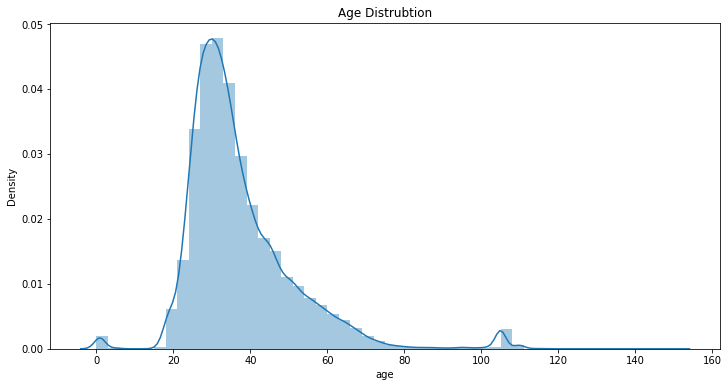

In [ ]:
plt.figure(figsize=(12,6))
sns.distplot(data.age.dropna())
plt.title('Age Distrubtion')
plt.show()

In [ ]:
data.loc[data.age>95,'age'] = np.NaN

In [ ]:
data.drop(data.loc[data['age']>95].index, inplace=True)


In [ ]:
data["age"].max()

95.0

####Drop null values in first-affliate-tracked

In [ ]:
data = data.dropna(subset=["first_affiliate_tracked"])

In [ ]:
data.isnull().sum()

id                              0
date_account_created            0
timestamp_first_active          0
date_first_booking         120216
gender                          0
age                         85600
signup_method                   0
signup_flow                     0
language                        0
affiliate_channel               0
affiliate_provider              0
first_affiliate_tracked         0
signup_app                      0
first_device_type               0
first_browser                   0
country_destination             0
dtype: int64

####fill null values in age with median and Convert age type into integer

In [ ]:
# get values in age without null
age_notnull=data['age'].notnull()
data[age_notnull]['age']

NameError: ignored

In [ ]:
sum(data['age'].notnull()) # number of values in age without nulls

121786

In [ ]:
statistics.mean(data[age_notnull]['age']) # calculate mean for age without null

36.27384921091094

In [ ]:
statistics.median(data[age_notnull]['age']) # calculate median for age without null

33.0

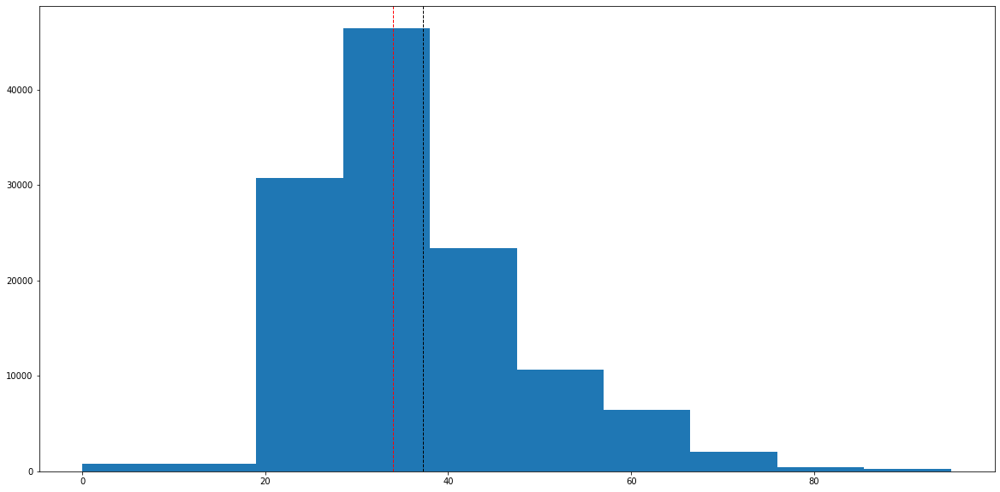

In [ ]:
# hitogram age without null
plt.figure(figsize=[20,10]) #figer size
plt.hist(data[age_notnull]['age']) #age histogram without null values
plt.axvline(x=37.21, color='k', linestyle='dashed', linewidth=1) #mean
plt.axvline(x=34.0, color='r', linestyle='dashed', linewidth=1) #median
plt.show()

there is no big different between mean and median values, but Distribution of data is skewed so median is better than mean in this case

In [ ]:
data['age'].fillna(34.0, inplace = True) # fill null values with median

In [ ]:
sum(data['age'].isnull()) # number of null values in age

0

In [ ]:
data.isnull().sum() # number of null values in all data

id                              0
date_account_created            0
timestamp_first_active          0
date_first_booking         120216
gender                          0
age                             0
signup_method                   0
signup_flow                     0
language                        0
affiliate_channel               0
affiliate_provider              0
first_affiliate_tracked         0
signup_app                      0
first_device_type               0
first_browser                   0
country_destination             0
dtype: int64

In [ ]:
 data.age = data.age.astype("int") #Convert type into integer
#we couldn't Convert age type into integer before fill null values in age

In [ ]:
data["date_first_booking"].value_counts()

2014-05-22    248
2014-06-11    231
2014-06-24    226
2014-05-21    225
2014-06-10    223
             ... 
2010-07-31      1
2010-02-17      1
2010-06-20      1
2010-02-27      1
2015-06-28      1
Name: date_first_booking, Length: 1957, dtype: int64

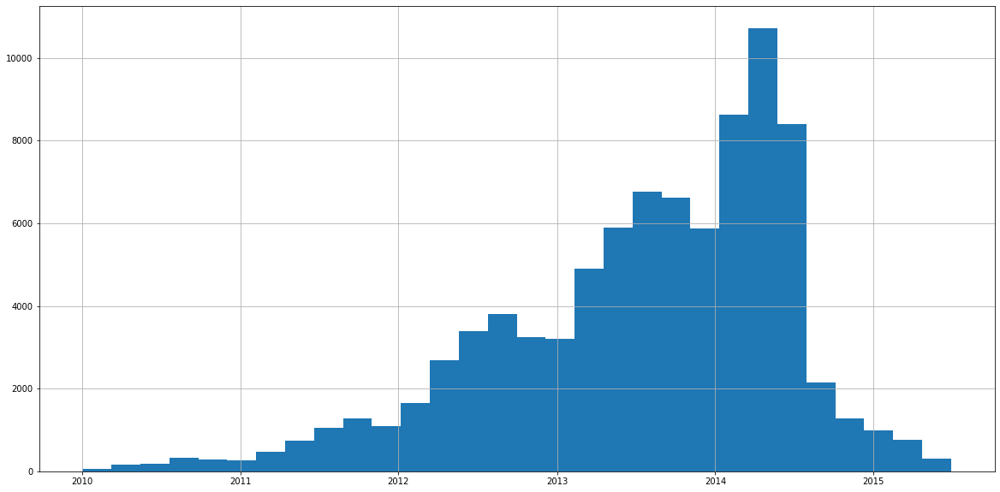

In [ ]:
plt.figure(figsize=(20,10))
data["date_first_booking"].hist(bins=30)

In [ ]:
data['time_btwn_created_booking'] = data['date_account_created'].sub(data['date_first_booking'], axis=0)
print(f"Most users take {abs(np.mean(data['time_btwn_created_booking']))} after creating account to book flight ")

Most users take 45 days 02:41:58.389354135 after creating account to book flight 


In [ ]:
data["time_btwn_created_booking"]=data["time_btwn_created_booking"].abs()

In [ ]:
data.head(5)

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination,time_btwn_created_booking
0,gxn3p5htnn,2010-06-28,2009-03-19 04:32:55,NaT,OTHER,34,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,NDF,NaT
1,820tgsjxq7,2011-05-25,2009-05-23 17:48:09,NaT,MALE,38,facebook,0,en,seo,google,untracked,Web,Mac Desktop,Chrome,NDF,NaT
2,4ft3gnwmtx,2010-09-28,2009-06-09 23:12:47,2010-08-02,FEMALE,56,basic,3,en,direct,direct,untracked,Web,Windows Desktop,IE,US,57 days
3,bjjt8pjhuk,2011-12-05,2009-10-31 06:01:29,2012-09-08,FEMALE,42,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Firefox,other,278 days
4,87mebub9p4,2010-09-14,2009-12-08 06:11:05,2010-02-18,FEMALE,41,basic,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,US,208 days
5,osr2jwljor,2010-01-01,2010-01-01 21:56:19,2010-01-02,FEMALE,34,basic,0,en,other,other,omg,Web,Mac Desktop,Chrome,US,1 days
6,lsw9q7uk0j,2010-01-02,2010-01-02 01:25:58,2010-01-05,FEMALE,46,basic,0,en,other,craigslist,untracked,Web,Mac Desktop,Safari,US,3 days
7,0d01nltbrs,2010-01-03,2010-01-03 19:19:05,2010-01-13,FEMALE,47,basic,0,en,direct,direct,omg,Web,Mac Desktop,Safari,US,10 days
8,a1vcnhxeij,2010-01-04,2010-01-04 00:42:11,2010-07-29,FEMALE,50,basic,0,en,other,craigslist,untracked,Web,Mac Desktop,Safari,US,206 days
9,6uh8zyj2gn,2010-01-04,2010-01-04 02:37:58,2010-01-04,FEMALE,46,basic,0,en,other,craigslist,omg,Web,Mac Desktop,Firefox,US,0 days


### Generate new columns

In [ ]:
data['month_first_book'] = pd.DatetimeIndex(data['date_first_booking']).month
data['quarter_first_book']= pd.DatetimeIndex(data['date_first_booking']).quarter
data['year_first_book']= pd.DatetimeIndex(data['date_first_booking']).year
data['DayOfWeek_first_book']= pd.DatetimeIndex(data['date_first_booking']).weekday


data['month_account_created'] = pd.DatetimeIndex(data['date_account_created']).month
data['quarter_account_created']= pd.DatetimeIndex(data['date_account_created']).quarter
data['year_account_created']= pd.DatetimeIndex(data['date_account_created']).year
data['DayOfWeek_account_created']= pd.DatetimeIndex(data['date_account_created']).weekday


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 207386 entries, 0 to 213450
Data columns (total 25 columns):
 #   Column                     Non-Null Count   Dtype          
---  ------                     --------------   -----          
 0   id                         207386 non-null  object         
 1   date_account_created       207386 non-null  datetime64[ns] 
 2   timestamp_first_active     207386 non-null  datetime64[ns] 
 3   date_first_booking         87170 non-null   datetime64[ns] 
 4   gender                     207386 non-null  category       
 5   age                        207386 non-null  int64          
 6   signup_method              207386 non-null  category       
 7   signup_flow                207386 non-null  category       
 8   language                   207386 non-null  category       
 9   affiliate_channel          207386 non-null  category       
 10  affiliate_provider         207386 non-null  category       
 11  first_affiliate_tracked    207386 non-n

###Replace missing values with mode

In [ ]:
data['month_first_book']= data['month_first_book'].fillna(data['month_first_book'].mode()[0])
data['quarter_first_book']= data['quarter_first_book'].fillna(data['quarter_first_book'].mode()[0])
data['year_first_book']= data['year_first_book'].fillna(data['year_first_book'].mode()[0])
data['DayOfWeek_first_book']= data['DayOfWeek_first_book'].fillna(data['DayOfWeek_first_book'].mode()[0])

In [ ]:
data.isnull().sum()

id                                0
date_account_created              0
timestamp_first_active            0
date_first_booking           120216
gender                            0
age                               0
signup_method                     0
signup_flow                       0
language                          0
affiliate_channel                 0
affiliate_provider                0
first_affiliate_tracked           0
signup_app                        0
first_device_type                 0
first_browser                     0
country_destination               0
time_btwn_created_booking    120216
month_first_book                  0
quarter_first_book                0
year_first_book                   0
DayOfWeek_first_book              0
month_account_created             0
quarter_account_created           0
year_account_created              0
DayOfWeek_account_created         0
dtype: int64

## **Correlation**:

### overlay histogarm: ( timestamp_first_active , date_account_created and date_first_booking )

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=data['timestamp_first_active'],name = "timestamp_first_active"))
fig.add_trace(go.Histogram(x=data['date_account_created'], name = "date_account_created"))


fig.update_layout(barmode='overlay')

fig.update_traces(opacity=0.75)
fig.show()

the corellation between date_account_created and timestamp_first_active is absolutely linear

date_account_created and timestamp_first_active have almost same values
and this make sense that data entry is correct at this postions as its logic that first time active is the date user create his account

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=data['timestamp_first_active'],name = "timestamp_first_active"))
fig.add_trace(go.Histogram(x=data['date_first_booking'], name = "date_first_booking"))


fig.update_layout(barmode='overlay')

fig.update_traces(opacity=0.75)
fig.show()

the corellation between date_first_booking and timestamp_first_active is approximately linear

number of users who booking less than who active

so not all users once they create account they book their first flight

### Correlation matrix

In [ ]:
# calculate Correlation matrix
corr_matrix = data.corr()
upper =corr_matrix.where(np.triu(np.ones(corr_matrix.shape),k=1).astype(bool))
upper

,age,month_first_book,quarter_first_book,year_first_book,DayOfWeek_first_book,month_account_created,quarter_account_created,year_account_created,DayOfWeek_account_created
age,NaN,0.003688,0.008467,-0.041816,0.009263,0.013082,0.015723,-0.067096,0.022392
month_first_book,NaN,NaN,0.940704,-0.312352,0.003868,0.448553,0.439814,-0.207908,-0.003336
quarter_first_book,NaN,NaN,NaN,-0.436019,0.067339,0.420744,0.436705,-0.225228,-0.005330
year_first_book,NaN,NaN,NaN,NaN,-0.175521,-0.161237,-0.171258,0.579528,0.003659
DayOfWeek_first_book,NaN,NaN,NaN,NaN,NaN,-0.002530,-0.002718,-0.025727,0.149256
month_account_created,NaN,NaN,NaN,NaN,NaN,NaN,0.967268,-0.450488,-0.008517
quarter_account_created,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.462758,-0.015578
year_account_created,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.011890
DayOfWeek_account_created,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


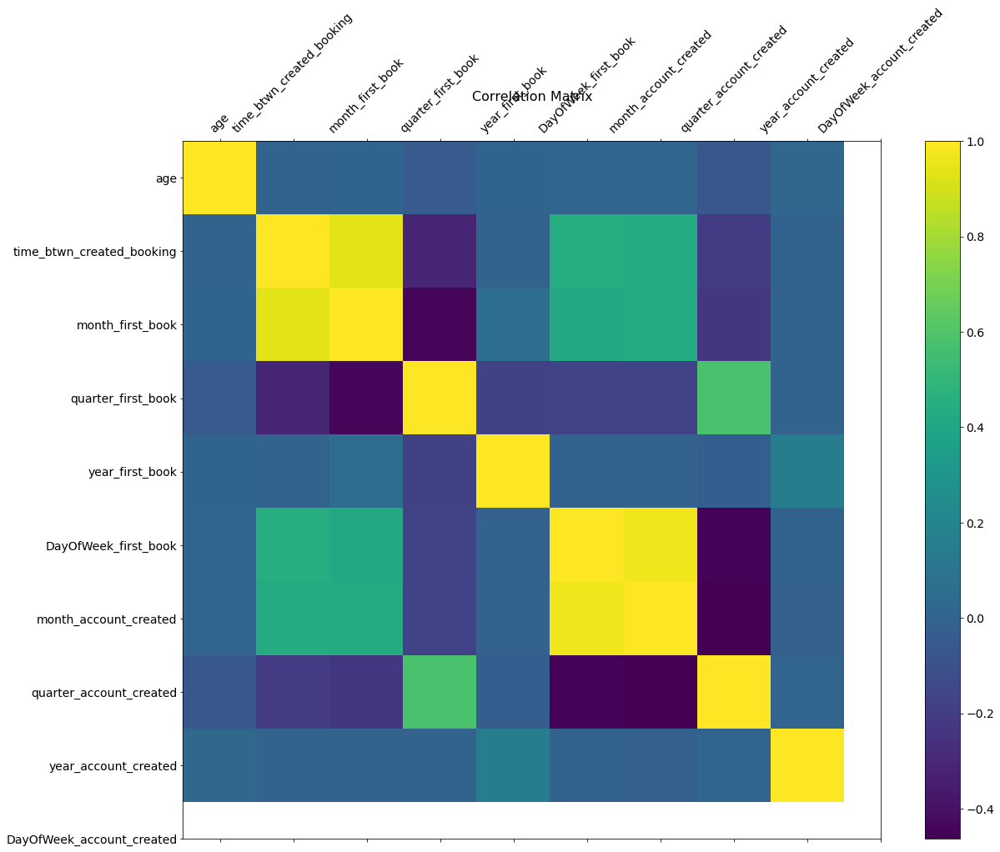

In [ ]:
#correlation graph (notice the difference in colours)
f = plt.figure(figsize=(19, 15))
plt.matshow(corr_matrix, fignum=f.number)
plt.xticks(range(data.select_dtypes(['number']).shape[1]), data.select_dtypes(['number']).columns, fontsize=14, rotation=45)
plt.yticks(range(data.select_dtypes(['number']).shape[1]), data.select_dtypes(['number']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

# **Visualizations**:

## Pie Charts:

### signup_app pie chart

In [ ]:
fig = px.pie(data, values=data['signup_app'].value_counts(), names=data.signup_app.value_counts().index.tolist())
fig.show()

most signup_app used by users is web

### gender pie chart

In [ ]:
fig = px.pie(data, values=data['gender'].value_counts(), names=data.gender.value_counts().index.tolist())
fig.show()

most users is Female

### signup_method pie chart

In [ ]:
fig = px.pie(data, values=data['signup_method'].value_counts(),names=data.signup_method.value_counts().index.tolist())
fig.show()

most signup_method used by users is bisic

### first_affiliate_tracked pie chart

In [ ]:
fig = px.pie(data, values=data['first_affiliate_tracked'].value_counts(),names=data.first_affiliate_tracked.value_counts().index.tolist())
fig.show()

most affiliate tracked is untracked then linked then omg

## Bar Plot:

### first_browser bar plot

In [ ]:
px.bar(x=data['first_browser'].value_counts().index.tolist(),y=data['first_browser'].value_counts(),color=data['first_browser'].value_counts().index.tolist())

most first_browser used by users is Chrome

### Most signup_flow: the page a user came to signup up from

In [ ]:
px.bar(x=data['signup_flow'].value_counts().index.tolist(),y=data['signup_flow'].value_counts(),color=data['signup_flow'].value_counts().index.tolist())

Most users came from page 0

### Top Booked Countries over years

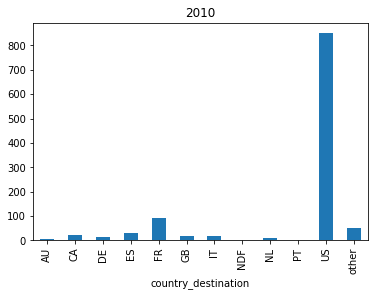

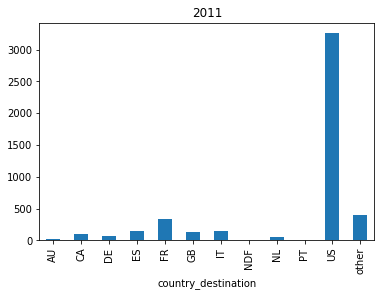

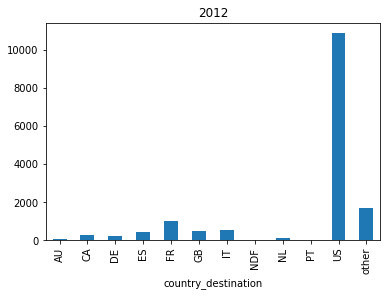

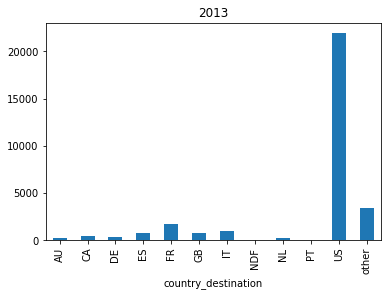

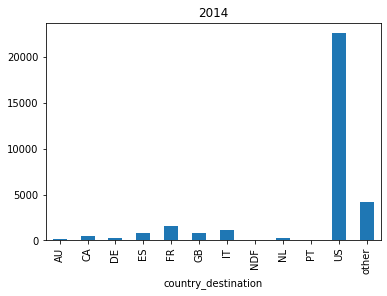

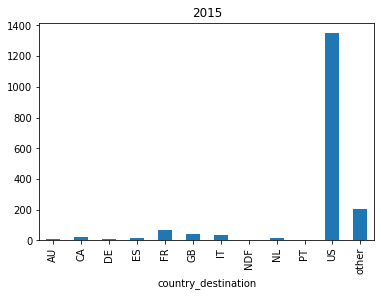

<Figure size 432x288 with 0 Axes>

In [ ]:
group = data.groupby([data["date_first_booking"].dt.year,"country_destination"])["id"].count()
for year in range(2010, 2016):
  group[year].plot(kind="bar", title=f"{year}")
  plt.show()
  plt.clf()

### language bar plot

In [ ]:
px.bar(x=data['language'].value_counts().index.tolist(),y=data['language'].value_counts())

# almost all users language is English

### first_device_type bar plot

In [ ]:
fig = px.bar(data, x=data.first_device_type.value_counts().index.tolist(), y=data.first_device_type.value_counts(), color=data.first_device_type.value_counts().index.tolist())
fig.show()

most two devices types used by users are mac then windows

### country_destination bar plot

In [ ]:
fig = px.bar(data, x=data.country_destination.value_counts().index.tolist(), y=data.country_destination.value_counts(), color=data.country_destination.value_counts().index.tolist())
fig.show()

most users doesn't make any travel

## Scatter Plot:

### Scatter plot to signup_flow with age

In [ ]:
fig = px.scatter(data, x='age',y='signup_flow')
fig.show()

there is no correlation between age and signup_flow

## Heat Map:

### heat map: first_device_type with country_destination

In [ ]:
fig = px.density_heatmap(data, x=data['first_device_type'], y=data["country_destination"])

fig.show()

number of users who use mac more than number of users who use windows for all country_destination

### heat map: age with country_destination

In [ ]:
fig = px.density_heatmap(data, y=data['age'], x=data["country_destination"])

fig.show()

most users age who created account is between 34 and 35 years

### heat map: first_device_type with first_browser

In [ ]:
fig = px.density_heatmap(data, x=data['first_browser'], y=data["first_device_type"])

fig.show()

most 3 browsers used in mac are (Safari, chrome and firefox)

most 3 browsers used in windows are (chrome, IE and firefox)

### heat map: affiliate_channel with affiliate_provider

In [ ]:
fig = px.density_heatmap(data, y=data['affiliate_provider'], x=data["affiliate_channel"])

fig.show()

### heat map: signup_method with gender

In [ ]:
fig = px.density_heatmap(data, x=data['signup_method'], y=data["gender"])

fig.show()

most signup_method are used by all genders is basic

### heat map: gender with country_destination

In [ ]:
fig = px.density_heatmap(data, x=data['country_destination'], y=data["gender"])

fig.show()

Females travels more than males for all countries but DE

## Tree Map:

### Tree Map: gender => country_destination => language

In [ ]:
fig = px.treemap(data, path=[px.Constant("gender"),"gender",px.Constant("country_destination"),'country_destination',px.Constant("language"),'language'])
fig.show()

[link text](https://)### Tree Map: signup_app => first_device_type => first_browser

In [ ]:
fig = px.treemap(data, path=[px.Constant("signup_app"),"signup_app",px.Constant("first_device_type"),'first_device_type',px.Constant("first_browser"),'first_browser'])
fig.show()

### Tree Map: country_destination => gender => signup_method

In [ ]:
fig = px.treemap(data, path=[px.Constant("country_destination"),"country_destination",px.Constant("gender"),'gender',px.Constant("signup_method"),'signup_method'])
fig.show()

#**Time Series**

In [ ]:
# data.year_account_created = pd.to_datetime(data.year_account_created, format="%Y")
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 206632 entries, 0 to 213450
Data columns (total 25 columns):
 #   Column                     Non-Null Count   Dtype          
---  ------                     --------------   -----          
 0   id                         206632 non-null  object         
 1   date_account_created       206632 non-null  datetime64[ns] 
 2   timestamp_first_active     206632 non-null  datetime64[ns] 
 3   date_first_booking         86804 non-null   datetime64[ns] 
 4   gender                     206632 non-null  category       
 5   age                        206632 non-null  int64          
 6   signup_method              206632 non-null  category       
 7   signup_flow                206632 non-null  category       
 8   language                   206632 non-null  category       
 9   affiliate_channel          206632 non-null  category       
 10  affiliate_provider         206632 non-null  category       
 11  first_affiliate_tracked    206632 non-n

In [ ]:
data.head()

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,...,country_destination,time_btwn_created_booking,month_first_book,quarter_first_book,year_first_book,DayOfWeek_first_book,month_account_created,quarter_account_created,year_account_created,DayOfWeek_account_created
0,gxn3p5htnn,2010-06-28,2009-03-19 04:32:55,NaT,OTHER,34,facebook,0,en,direct,...,NDF,NaT,6.0,2.0,2014.0,2.0,6,2,2010,0
1,820tgsjxq7,2011-05-25,2009-05-23 17:48:09,NaT,MALE,38,facebook,0,en,seo,...,NDF,NaT,6.0,2.0,2014.0,2.0,5,2,2011,2
2,4ft3gnwmtx,2010-09-28,2009-06-09 23:12:47,2010-08-02,FEMALE,56,basic,3,en,direct,...,US,57 days,8.0,3.0,2010.0,0.0,9,3,2010,1
3,bjjt8pjhuk,2011-12-05,2009-10-31 06:01:29,2012-09-08,FEMALE,42,facebook,0,en,direct,...,other,278 days,9.0,3.0,2012.0,5.0,12,4,2011,0
4,87mebub9p4,2010-09-14,2009-12-08 06:11:05,2010-02-18,FEMALE,41,basic,0,en,direct,...,US,208 days,2.0,1.0,2010.0,3.0,9,3,2010,1


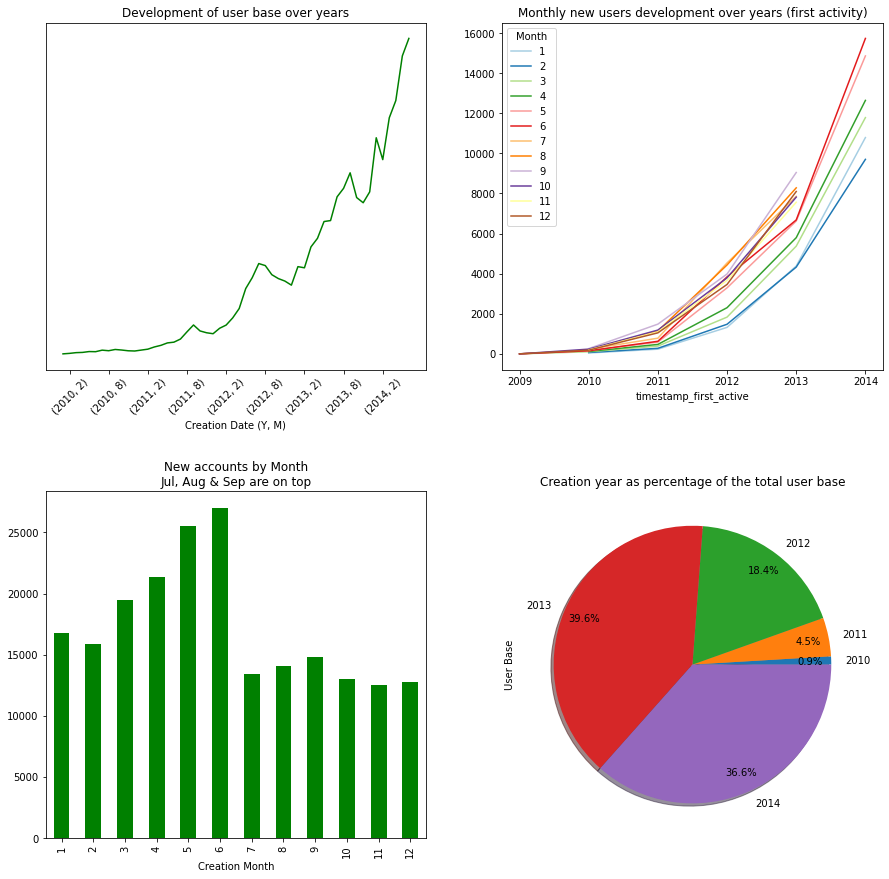

In [ ]:
fig = plt.figure(figsize=(15,15))
plt.subplot(221)
grouped_df = data.groupby([data.date_account_created.dt.year, data.date_account_created.dt.month]).count().id
grouped_df.plot(kind='line', xticks=range(1, len(grouped_df), 6), rot=45, color='g')
plt.xlabel('Creation Date (Y, M)')
plt.yticks([])
plt.title('Development of user base over years')

ax = fig.add_subplot(222)
data.groupby([data.timestamp_first_active.dt.year,
                  data.timestamp_first_active.dt.month]).count().id.unstack().plot(
                    kind='line', ax=ax,
                    xticks=range(data.timestamp_first_active.dt.year.min(),
                                 data.timestamp_first_active.dt.year.max()+1),
                                 colormap='Paired')
plt.title('Monthly new users development over years (first activity)')
ax.legend(title='Month')

plt.subplot(223)
data.groupby([data.date_account_created.dt.month]).count().id.plot(kind='bar', color='g')
plt.title('New accounts by Month\nJul, Aug & Sep are on top')
plt.xlabel('Creation Month')

plt.subplot(224)
data.groupby([data.date_account_created.dt.year]).count().id.plot(kind='pie', shadow=True, autopct='%.1f%%', pctdistance=0.85)
plt.title('Creation year as percentage of the total user base')
plt.ylabel('User Base')

plt.subplots_adjust(hspace=0.35)
plt.show()

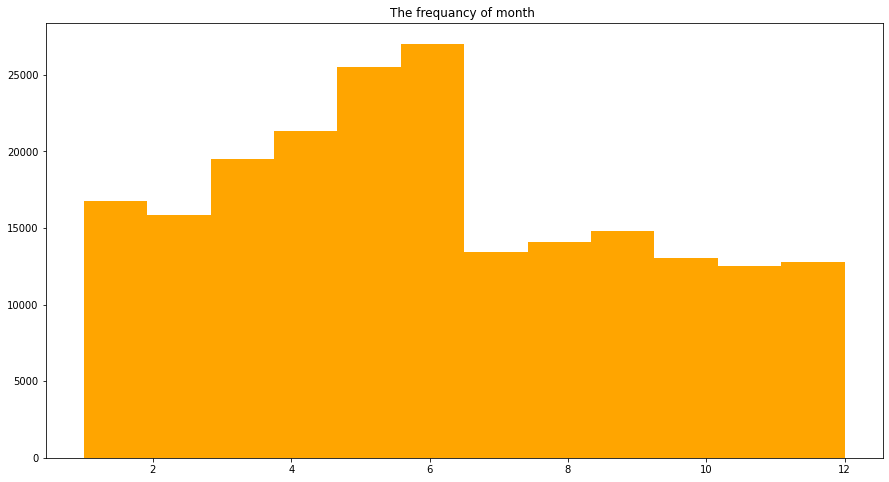

In [ ]:
plt.figure(figsize = (15,8))

plt.hist(data['month_account_created'], color = 'orange', bins= 12)

plt.title("The frequancy of month ");
#at the begining of summer (may and june) 2 most months where new accounts created

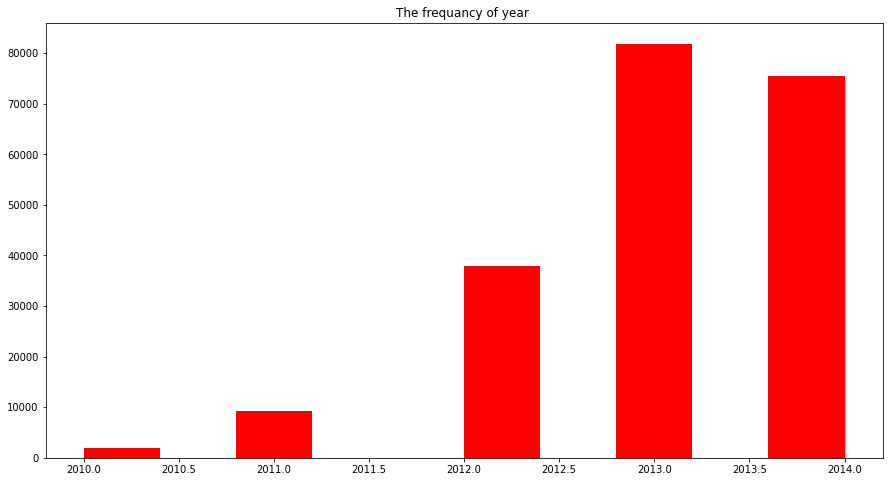

In [ ]:
plt.figure(figsize = (15,8))

plt.hist(data['year_account_created'], color = 'red', bins= 10)

plt.title("The frequancy of year ");
#at 2013 the most year that new users come and create new accounts then 2014 their was a slight decrease.

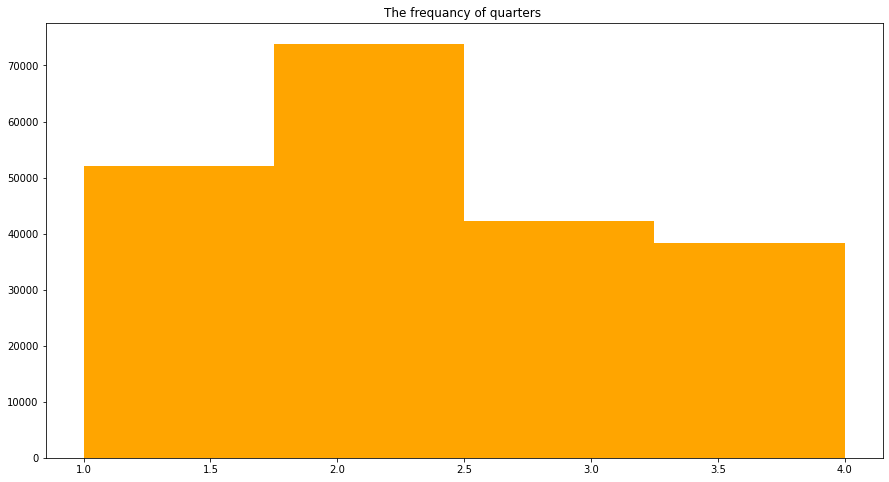

In [ ]:
plt.figure(figsize = (15,8))

plt.hist(data['quarter_account_created'], color = 'orange', bins= 4)

plt.title("The frequancy of quarters ");
#quarters are [(1,2,3),(4,5,6),(7,8,9),(10,11,12)]
# so second quarter is prefered by users (4,5,6).

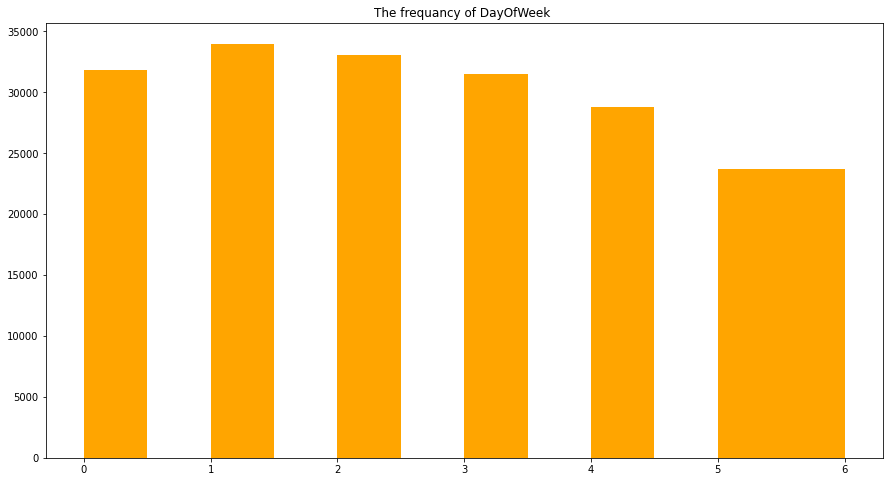

In [ ]:
plt.figure(figsize = (15,8))

plt.hist(data['DayOfWeek_account_created'], color = 'orange', bins= 12)

plt.title("The frequancy of DayOfWeek ");
# day 0 is monday


In [ ]:
data["country_destination"].nunique()

12

In [ ]:
data["country_destination"].value_counts()

NDF      119828
US        60818
other      9937
FR         4882
IT         2776
GB         2285
ES         2203
CA         1385
DE         1033
NL          746
AU          526
PT          213
Name: country_destination, dtype: int64

In [ ]:
data.head(3)

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,...,country_destination,time_btwn_created_booking,month_first_book,quarter_first_book,year_first_book,DayOfWeek_first_book,month_account_created,quarter_account_created,year_account_created,DayOfWeek_account_created
0,gxn3p5htnn,2010-06-28,2009-03-19 04:32:55,NaT,OTHER,34,facebook,0,en,direct,...,NDF,NaT,6.0,2.0,2014.0,2.0,6,2,2010,0
1,820tgsjxq7,2011-05-25,2009-05-23 17:48:09,NaT,MALE,38,facebook,0,en,seo,...,NDF,NaT,6.0,2.0,2014.0,2.0,5,2,2011,2
2,4ft3gnwmtx,2010-09-28,2009-06-09 23:12:47,2010-08-02,FEMALE,56,basic,3,en,direct,...,US,57 days,8.0,3.0,2010.0,0.0,9,3,2010,1


In [ ]:
#data["date_account_created"].dt.year.value_counts()
my_dict={"ds":data["date_account_created"].value_counts().index.tolist(),"y":data["date_account_created"].value_counts()}
# my_dict
#df=pd.dataframe(data["date_account_created"].dt.year.value_counts())
df=pd.DataFrame(my_dict)
df

,ds,y
2014-05-13,2014-05-13,672
2014-06-24,2014-06-24,670
2014-06-25,2014-06-25,636
2014-05-20,2014-05-20,632
2014-05-14,2014-05-14,622
...,...,...
2010-06-26,2010-06-26,1
2010-02-21,2010-02-21,1
2010-02-18,2010-02-18,1
2010-02-17,2010-02-17,1


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1629 entries, 2014-05-13 to 2010-03-28
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      1629 non-null   datetime64[ns]
 1   y       1629 non-null   int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 38.2 KB


In [ ]:
df["ds"].max()

Timestamp('2014-06-30 00:00:00')

In [ ]:
m = Prophet()
m.fit(df)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxa_cyao2/l97f_9hm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxa_cyao2/bp4jnkuy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64759', 'data', 'file=/tmp/tmpxa_cyao2/l97f_9hm.json', 'init=/tmp/tmpxa_cyao2/bp4jnkuy.json', 'output', 'file=/tmp/tmpclknzci8/prophet_model-20220912204941.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:49:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:49:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
future = m.make_future_dataframe(periods=365)
future.tail()

,ds
1989,2015-06-26
1990,2015-06-27
1991,2015-06-28
1992,2015-06-29
1993,2015-06-30


In [ ]:
forecast = m.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
1989,2015-06-26,797.244120,733.402177,857.473154
1990,2015-06-27,775.772081,713.650549,832.016256
1991,2015-06-28,776.502186,709.465191,838.603488
1992,2015-06-29,811.919736,744.691098,869.632973
1993,2015-06-30,823.894944,762.993763,887.303976


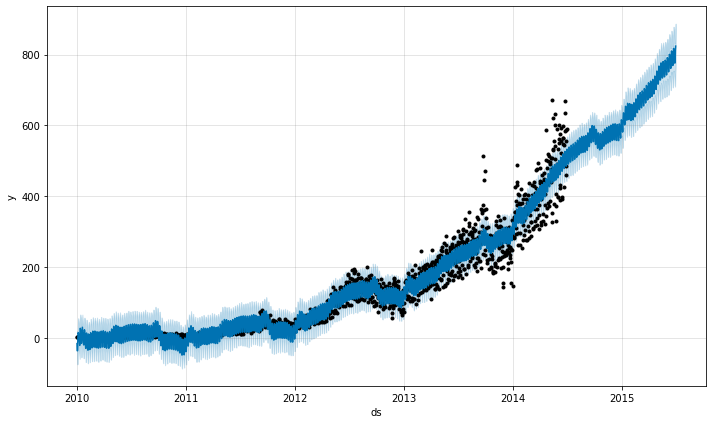

In [ ]:
fig1 = m.plot(forecast)

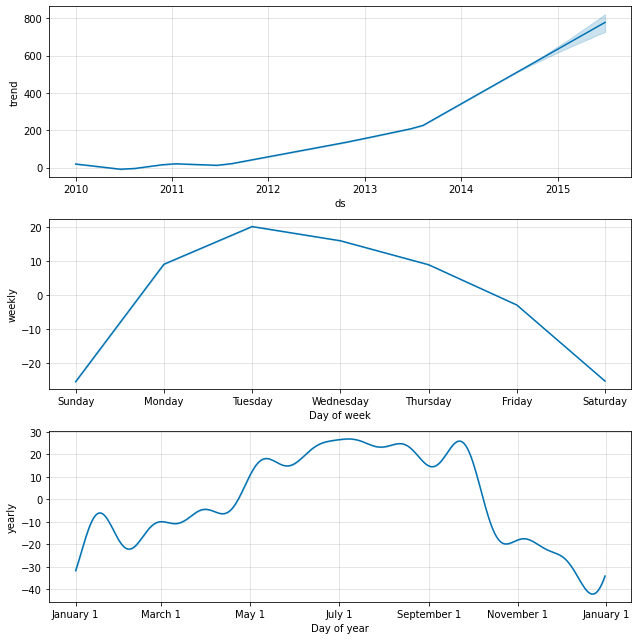

In [ ]:
fig2 = m.plot_components(forecast)

In [ ]:
my_dict2={"ds":data["date_first_booking"].value_counts().index.tolist(),"y":data["date_first_booking"].value_counts()}
df2=pd.DataFrame(my_dict2)
df2

,ds,y
2014-05-22,2014-05-22,248
2014-06-11,2014-06-11,231
2014-06-24,2014-06-24,226
2014-05-21,2014-05-21,225
2014-06-10,2014-06-10,223
...,...,...
2011-03-02,2011-03-02,1
2010-03-27,2010-03-27,1
2010-03-30,2010-03-30,1
2010-04-01,2010-04-01,1


In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1957 entries, 2014-05-22 to 2015-06-28
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      1957 non-null   datetime64[ns]
 1   y       1957 non-null   int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 45.9 KB


In [ ]:
m2 = Prophet()
m2.fit(df2)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxa_cyao2/zpod55wi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxa_cyao2/spac323p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76231', 'data', 'file=/tmp/tmpxa_cyao2/zpod55wi.json', 'init=/tmp/tmpxa_cyao2/spac323p.json', 'output', 'file=/tmp/tmpsiudqud7/prophet_model-20220912204946.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:49:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:49:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
future2 = m.make_future_dataframe(periods=365)
future2.tail()

,ds
1989,2015-06-26
1990,2015-06-27
1991,2015-06-28
1992,2015-06-29
1993,2015-06-30


In [ ]:
forecast2 = m2.predict(future2)
forecast2[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
1989,2015-06-26,-17.916838,-42.538142,7.162493
1990,2015-06-27,-29.965359,-55.833267,-5.824916
1991,2015-06-28,-33.588610,-59.998634,-8.587498
1992,2015-06-29,-25.296999,-49.899011,0.051406
1993,2015-06-30,-21.766687,-47.855812,2.599350


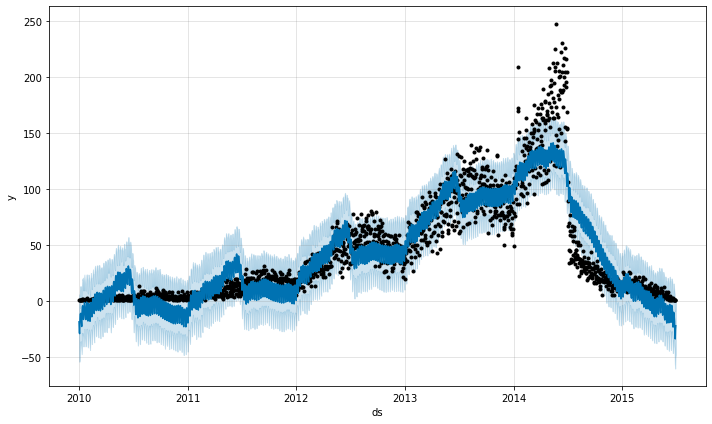

In [ ]:
fig1 = m2.plot(forecast2)

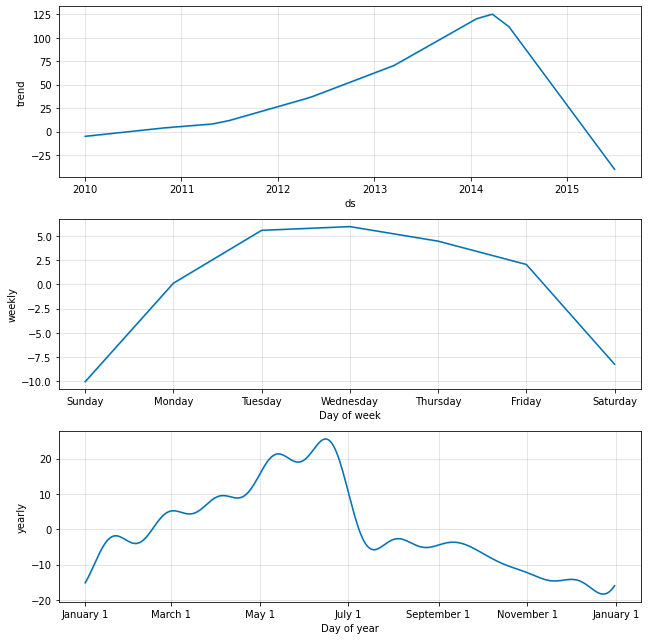

In [ ]:
fig2 = m2.plot_components(forecast2)

#**Modeling**

## Transforn Categorical data to numerical

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 206632 entries, 0 to 213450
Data columns (total 25 columns):
 #   Column                     Non-Null Count   Dtype          
---  ------                     --------------   -----          
 0   id                         206632 non-null  object         
 1   date_account_created       206632 non-null  datetime64[ns] 
 2   timestamp_first_active     206632 non-null  datetime64[ns] 
 3   date_first_booking         86804 non-null   datetime64[ns] 
 4   gender                     206632 non-null  category       
 5   age                        206632 non-null  int64          
 6   signup_method              206632 non-null  category       
 7   signup_flow                206632 non-null  category       
 8   language                   206632 non-null  category       
 9   affiliate_channel          206632 non-null  category       
 10  affiliate_provider         206632 non-null  category       
 11  first_affiliate_tracked    206632 non-n

In [ ]:

categorical_features = ['gender', 'signup_method', "signup_flow", 'language','affiliate_channel', 'affiliate_provider', 'first_affiliate_tracked', 'signup_app',
                        'first_device_type', 'first_browser']
data = pd.get_dummies(data, columns=categorical_features)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 206632 entries, 0 to 213450
Columns: 161 entries, id to first_browser_wOSBrowser
dtypes: category(1), datetime64[ns](3), float64(4), int64(5), object(1), timedelta64[ns](1), uint8(146)
memory usage: 52.6+ MB


In [ ]:
data

,id,date_account_created,timestamp_first_active,date_first_booking,age,country_destination,time_btwn_created_booking,month_first_book,quarter_first_book,year_first_book,...,first_browser_SeaMonkey,first_browser_Silk,first_browser_SiteKiosk,first_browser_SlimBrowser,first_browser_Sogou Explorer,first_browser_Stainless,first_browser_TenFourFox,first_browser_TheWorld Browser,first_browser_Yandex.Browser,first_browser_wOSBrowser
0,gxn3p5htnn,2010-06-28,2009-03-19 04:32:55,NaT,34,NDF,NaT,6.0,2.0,2014.0,...,0,0,0,0,0,0,0,0,0,0
1,820tgsjxq7,2011-05-25,2009-05-23 17:48:09,NaT,38,NDF,NaT,6.0,2.0,2014.0,...,0,0,0,0,0,0,0,0,0,0
2,4ft3gnwmtx,2010-09-28,2009-06-09 23:12:47,2010-08-02,56,US,57 days,8.0,3.0,2010.0,...,0,0,0,0,0,0,0,0,0,0
3,bjjt8pjhuk,2011-12-05,2009-10-31 06:01:29,2012-09-08,42,other,278 days,9.0,3.0,2012.0,...,0,0,0,0,0,0,0,0,0,0
4,87mebub9p4,2010-09-14,2009-12-08 06:11:05,2010-02-18,41,US,208 days,2.0,1.0,2010.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213446,zxodksqpep,2014-06-30,2014-06-30 23:56:36,NaT,32,NDF,NaT,6.0,2.0,2014.0,...,0,0,0,0,0,0,0,0,0,0
213447,mhewnxesx9,2014-06-30,2014-06-30 23:57:19,NaT,34,NDF,NaT,6.0,2.0,2014.0,...,0,0,0,0,0,0,0,0,0,0
213448,6o3arsjbb4,2014-06-30,2014-06-30 23:57:54,NaT,32,NDF,NaT,6.0,2.0,2014.0,...,0,0,0,0,0,0,0,0,0,0
213449,jh95kwisub,2014-06-30,2014-06-30 23:58:22,NaT,34,NDF,NaT,6.0,2.0,2014.0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
data.shape

(206632, 161)

In [ ]:
data = data.set_index("id")

[link text](https://)##Transforming the target variable using labels

In [ ]:
# Dividing data into X and y
X = data.drop(['country_destination','date_account_created', 'timestamp_first_active', 'date_first_booking', 'time_btwn_created_booking'], axis = 1)
Y = data['country_destination']

label_encoder = LabelEncoder()
encoded_y = label_encoder.fit_transform(Y)
encoded_y

array([ 7,  7, 10, ...,  7,  7,  7])

In [ ]:
data["country_destination"].unique()

['NDF', 'US', 'other', 'CA', 'FR', ..., 'IT', 'PT', 'NL', 'DE', 'AU']
Length: 12
Categories (12, object): ['AU', 'CA', 'DE', 'ES', ..., 'NL', 'PT', 'US', 'other']

In [ ]:
encoded_y[0:40]

array([ 7,  7, 10, 11, 10, 10, 10, 10, 10, 10, 10,  7,  7,  7,  1,  4, 10,
       10,  7,  7,  4,  7, 10, 10,  4,  7,  7, 10,  7,  7,  7,  7, 10, 10,
        3,  7, 10, 10,  7, 10])

##COUNTRY DESTINATION VALUES AFTER ENCODING ITS 12 CATEGORIES

0:AU
1:CA

2:DE

3:ES

4:fr

5:GB

6:IT

7:NDF

8:NL

9:PT

10:US

11:other

##Standardizing  age column:

In [ ]:
st_cols= pd.DataFrame(StandardScaler().fit_transform(X[["age"]]), columns=['age'] )
X['age'] = st_cols.values
X['age']

id
gxn3p5htnn   -0.163302
820tgsjxq7    0.283943
4ft3gnwmtx    2.296544
bjjt8pjhuk    0.731188
87mebub9p4    0.619376
                ...   
zxodksqpep   -0.386924
mhewnxesx9   -0.163302
6o3arsjbb4   -0.386924
jh95kwisub   -0.163302
nw9fwlyb5f   -0.163302
Name: age, Length: 206632, dtype: float64

In [ ]:
X["age"].max()

6.657179637330996

In [ ]:
X["age"].min()

-2.2877140768434763

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X,encoded_y,test_size=0.3, random_state=30, stratify=encoded_y)

##Machine Model

In [ ]:
from xgboost import XGBClassifier, plot_importance
xgb = XGBClassifier(use_label_encoder=True)
xgb.fit(x_train, y_train)

XGBClassifier(objective='multi:softprob', use_label_encoder=True)

In [ ]:
y_pred = xgb.predict(x_test)

In [ ]:
y_pred[1:100]

array([ 7,  7, 10,  7,  7, 10,  7,  7,  7,  7, 10,  7,  7, 10,  7, 10,  7,
        7,  7,  7,  7,  7, 10,  7, 10, 10, 10,  7, 10,  7,  7,  7,  7, 10,
        7,  7,  7, 10, 10,  7,  7,  7, 10, 10,  7, 10, 10, 10,  7, 10, 10,
        7,  7, 10, 10,  7, 10,  7,  7,  7, 10, 10,  7,  7, 10, 10,  7,  7,
       10,  7,  7, 10,  7, 10,  7, 10, 10,  7, 10,  7,  7,  7,  7, 10,  7,
        7,  7, 10,  7, 10,  7, 10,  7,  7, 10,  7, 10,  7,  7])

## Calculate model accuracy

In [ ]:
accuracy = xgb.score(x_test, y_test)
accuracy*100

87.09469269236973